# **Fundamentals of Pandas and Polars in scientific applications**

### Tutorial for participants of PyCon PL 2024
### Lidia Lipińska-Zubrycka (University of Warsaw) & Igor Zubrycki (Lodz University of Technology)

# What are Pandas and Polars?

Both Pandas and Polars are frameworks designed to work with **tabular data**—data that fits into tables, which can sometimes be extremely large. This kind of data is commonly derived from various scientific experiments.

In this guide, we will work with medical data and data from robotics. In both cases, the results are stored in files that consist of tables.

These frameworks enable us to work efficiently on common tasks related to tabular data analysis. This includes finding and selecting relevant data (filtering), performing various operations on columns, creating new tables (pivoting, grouping by), and visualizing the data.


# The comparison of Pandas and Polars
When comparing the Python libraries **Pandas** and **Polars** for data manipulation, each offers distinct features and performance characteristics suitable for different use cases. Here's a breakdown of the pros and cons of each:

## **Pandas**
### Pros:

* **Popularity and Community:** Pandas is widely used in the data science community, which means it has extensive documentation, a wealth of tutorials and resources, and a large community for support.
* **Feature-Rich:** Offers comprehensive data manipulation capabilities for data cleaning, transformation, and analysis.
* **Integration:** Well-integrated with other data science libraries in Python, such as Matplotlib, Scikit-Learn, and Statsmodels.
* **Flexible Data Structures:** Provides flexible data structures like DataFrame and Series that are intuitive to use and powerful for handling tabular data.
### Cons:
* **Performance:** Can be slow with large datasets (>1 million rows) due to its inherent single-threaded nature.
* **Memory Usage:**  Often requires a lot of memory, making it less efficient for very large data sets.
* **Complexity:**  Some operations in Pandas can be verbose and complex, requiring multiple steps or custom functions.

## **Polars**

### Pros:
* **Performance:**  Designed for speed and efficiency, Polars is built on Rust and can handle large datasets much faster than Pandas due to its use of multithreading and optimized memory management.
* **Lazy Evaluation:** Supports lazy execution (query plans that optimize and defer computation), which can be more efficient for complex data pipelines.
* **Less Memory Consumption:** Typically uses less memory than Pandas, making it more suitable for large data sets on limited hardware.
* **Modern API:** Offers a clean and modern API that can be easier to use for certain operations, especially with its expressive query syntax.
### Cons:
* **(Much) Younger Library:** While growing, Polars does not yet have the same level of community support, breadth of resources, or third-party integrations as Pandas. 
* **Fewer Features:** Though rapidly evolving, Polars currently has fewer features than Pandas, especially in areas of detailed statistical analysis or specialized data manipulations.
* **API Familiarity:** Users familiar with Pandas might find it initially challenging to switch due to differences in API and functionality.


### Conclusions
Let's learn both :-)

# Import libraries

In addition to Pandas and Polars, which are not part of the Python standard library, we must import other necessary libraries for data manipulation, visualization, and scientific computation. These include NumPy, Seaborn, and Matplotlib. We instruct Python to load these libraries with the following code:

In [ ]:
# Import libraries

import pandas as pd

from datetime import date

%matplotlib inline

# Pandas


## Pandas DataFrame - how to create/import it?

A **DataFrame** is a two-dimensional data structure in pandas, similar to a table in a relational database. There are several ways to create a DataFrame.


## Read dataset

In [ ]:
from google.colab import drive
#drive.mount('/content/drive')

#file_path = 'drive/MyDrive/PyConPl23/breast_cancer_diagnostic_data.csv'

!wget https://raw.githubusercontent.com/lidkalee/PyConPL23_Pandas/master/breast_cancer_diagnostic_data.csv
cancer_data = pd.read_csv(file_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#cancer_data = pd.read_csv('breast_cancer_diagnostic_data.csv')


## Description of dataset
The results show data obtained from a breast tumor biopsy along with the diagnosis: malignant or benign form of cancer.


**Features:**

1. ID number
2. Diagnosis (M = malignant (złośliwy), B = benign (łagodny))

**Ten real-valued features are computed for each cell nucleus:**

* radius (mean of distances from center to points on the perimeter)
* texture (standard deviation of gray-scale values)
* perimeter
* area
* moothness (local variation in radius lengths)
* compactness (perimeter^2 / area - 1.0)
* concavity (severity of concave portions of the contour)
* concave points (number of concave portions of the contour)
* symmetry
* fractal dimension ("coastline approximation" - 1)


Source:: https://archive.ics.uci.edu/dataset/17/breast+cancer+wisconsin+diagnostic

## Getting help about Pandas functions

*   Using the Pandas documentation [link text](https://pandas.pydata.org/pandas-docs/stable/)
*   Asking Chat GDP for help
*   Using the help() function
*   Using the ? operator



In [ ]:
# Examples
help(pd.DataFrame)

## Pandas provides a variety of ways to view and inspect your data

In [ ]:
# head(): This function returns the first n rows of your DataFrame. By default, it shows the first 5 rows.
cancer_data.head()

In [ ]:
#info(): This method provides a concise summary of the DataFrame including the number of non-null values in each column, and the datatype of each column.
cancer_data.info()

In [ ]:
# dtypes: This attribute returns the datatypes of each column.
cancer_data.dtypes

In [ ]:
# describe(): This function provides descriptive statistics that summarize the central tendency, dispersion, and shape of a dataset’s distribution, excluding NaN values.
cancer_data.describe()


In [ ]:
# shape: This attribute returns a tuple representing the dimensionality of the DataFrame (rows, columns).
cancer_data.shape

In [ ]:
# columns: This attribute returns the column labels of the DataFrame.
cancer_data.columns

In [ ]:
#loc and iloc: These two attributes allow you to access groups of rows and columns in a DataFrame. loc is label-based, which means you have to specify the name of the rows and columns that you need to filter out. On the other hand, iloc is integer index-based, so you have to specify rows and columns by their integer index.
print(cancer_data.loc[0])  # Prints the first row
#print(cancer_data.iloc[0])  # Also prints the first row

## Data exploration

In [ ]:
## How many patients have been diagnosed with malignant and how many with benign tumors?
cancer_data['diagnosis'].value_counts()

## ***Exercise:***
What percentage of the examined patients have been diagnosed with a malignant tumor and how many with a benign one? Hint: Refer to the documentation for the value_counts() function.

In [ ]:
# place for your code


## Different methods of subsetting rows and/or columns.

Pandas provides several methods for indexing rows and/or columns. Here are some common techniques:

* Selection by Label (**df.loc[]**): loc is primarily label-based indexing. It can accept single labels, lists of labels, slices of labels, boolean arrays, or a callable function with one argument.



```
df.loc[row_label, column_label]  # Single row, single column
df.loc[row_label, :]  # Single row, all columns
df.loc[:, column_label]  # All rows, single column
df.loc[[row_label1, row_label2], [column_label1, column_label2]]  # Multiple rows and columns
```

* Selection by Position (**df.iloc[]**): iloc is primarily integer-based indexing. It can accept integers, lists of integers, slices of integers, boolean arrays, or a callable function with one argument.


```
df.iloc[row_index, column_index]  # Single row, single column
df.iloc[row_index, :]  # Single row, all columns
df.iloc[:, column_index]  # All rows, single column
df.iloc[[row_index1, row_index2], [column_index1, column_index2]]  # Multiple rows and columns
```

* **Boolean Indexing**: This type of indexing is used when we want to filter rows from a DataFrame based on a certain condition.



```
df[df['column_label'] > value]  # Rows where the column is greater than value
df[(df['column_label1'] > value1) & (df['column_label2'] < value2)]  # Applying multiple conditions
```
* **Using df.at[]** and df.iat[]: For getting or setting a single value from a DataFrame. at uses label-based indexing and iat uses integer-based indexing.



#### Subsetting columns

In [ ]:
## Subsetting columns by name
cancer_data['diagnosis']

In [ ]:
cancer_data.diagnosis

## ***Exercise:***
Use one of the methods above to create an object containing the 'id' column from the cancer_data table, and check what type of object it is

In [ ]:
# Place for your code


In [ ]:
## Select specific columns and prepare subset of DataFrame
cancer_subset = cancer_data[['id', 'diagnosis', 'radius_mean']]
cancer_subset.head()

,id,diagnosis,radius_mean
0,842302,M,17.99
1,842517,M,20.57
2,84300903,M,19.69
3,84348301,M,11.42
4,84358402,M,20.29


In [ ]:
# Check the information of a given patient ('id' column)

cancer_data.iloc[1:]

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
5,843786,M,12.45,15.70,82.57,477.1,0.12780,0.17000,0.15780,0.08089,...,23.75,103.40,741.6,0.17910,0.52490,0.5355,0.1741,0.3985,0.12440,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


In [ ]:
cancer_data.iloc[5:8] # 8th row is not included

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
5,843786,M,12.45,15.70,82.57,477.1,0.12780,0.1700,0.15780,0.08089,...,23.75,103.4,741.6,0.1791,0.5249,0.5355,0.1741,0.3985,0.12440,NaN
6,844359,M,18.25,19.98,119.60,1040.0,0.09463,0.1090,0.11270,0.07400,...,27.66,153.2,1606.0,0.1442,0.2576,0.3784,0.1932,0.3063,0.08368,NaN
7,84458202,M,13.71,20.83,90.20,577.9,0.11890,0.1645,0.09366,0.05985,...,28.14,110.6,897.0,0.1654,0.3682,0.2678,0.1556,0.3196,0.11510,NaN


### **Excercise**
Prepare new DataFrame called cancer_data_subset, containing first 11 columns of original DataFrame

In [ ]:
# Place for your code
list_col = list(cancer_data.columns)[:12]
cancer_data_subset = cancer_data[list_col]
cancer_data_subset.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883


## Boolean subsetting DataFrame

In [ ]:
cancer_data_M = cancer_data[cancer_data['diagnosis']=='M']
#cancer_M['diagnosis'].value_counts()

M    212
Name: diagnosis, dtype: int64

In [ ]:
cancer_data[cancer_data['area_mean']>1000]

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.8,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.6,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.9,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.8,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.0,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.5,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
4,84358402,M,20.29,14.34,135.1,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.2,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN
6,844359,M,18.25,19.98,119.6,1040.0,0.09463,0.10900,0.1127,0.07400,...,27.66,153.2,1606.0,0.1442,0.2576,0.3784,0.1932,0.3063,0.08368,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
535,919555,M,20.55,20.86,137.8,1308.0,0.10460,0.17390,0.2085,0.13220,...,25.48,160.2,1809.0,0.1268,0.3135,0.4433,0.2148,0.3077,0.07569,NaN
563,926125,M,20.92,25.09,143.0,1347.0,0.10990,0.22360,0.3174,0.14740,...,29.41,179.1,1819.0,0.1407,0.4186,0.6599,0.2542,0.2929,0.09873,NaN
564,926424,M,21.56,22.39,142.0,1479.0,0.11100,0.11590,0.2439,0.13890,...,26.40,166.1,2027.0,0.1410,0.2113,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.2,1261.0,0.09780,0.10340,0.1440,0.09791,...,38.25,155.0,1731.0,0.1166,0.1922,0.3215,0.1628,0.2572,0.06637,NaN


### **Excercise**
Prepare a subset of data containing only rows with 'area_mean' higher than average. Please check the frequency of patients with malignant and benign diagnosis

In [ ]:
# Place for your code

#cancer_data[cancer_data["area_mean"] > cancer_data["area_mean"].mean()]

## Drop columns or rows
* **Dropping columns**:
To drop one or more columns from a DataFrame, you can use the following syntax:


```
df.drop(['column_name1', 'column_name2'], axis=1)
```
Here, 'column_name1' and 'column_name2' are the names of the columns you want to drop. axis=1 specifies that you want to drop columns.

* **Dropping rows**:
To drop one or more rows from a DataFrame, you can use:


```
df.drop([index1, index2], axis=0)
```
Here, 'index1' and 'index2' are the indices of the rows you want to drop. axis=0 specifies that you want to drop rows.

In both cases, the drop() function doesn't modify the original DataFrame but returns a new one. If you want to modify the original DataFrame, you can use the **inplace=True** argument:


```
df.drop(['column_name'], axis=1, inplace=True)
df.drop([index], axis=0, inplace=True)
```
Replace 'df' with your DataFrame's name, 'column_name1', 'column_name2' with the names of the columns you want to drop, and 'index1', 'index2' with the indices of the rows you want to drop.




In [ ]:
# drop columns from the table (output: table without selected column)
# axis = 1 tells the function to apply the operation to the column

cancer_data.drop('compactness_mean', axis = 1)

In [ ]:
# drop lins from the table by index (output: table without row 5)
# axis = 0 tells the function to apply the operation to the rows

cancer_data.drop(5, axis = 0)

In [ ]:
# drop several lines (5-100) from the table by index
# axis = 0 tells the function to apply the operation to the rows

cancer_data.drop(range(5,100), axis = 0)

In [ ]:
# select slices of lines and columns simultaneously by their index
# left side of the comma concerns row indexes (slice lines 50 to 100)
# rigth side of the comma concerns column indexes (slice col 5 to 10)

cancer_data.iloc[50:100, 5:10]

In [ ]:
# to drop columns containing missing values (Nan)

cancer_data.dropna(axis = 1)

In [ ]:
# to drop lines containing missing values (Nan)
# (there is no lines containing missing values here)
cancer_data.dropna(axis = 0)

## Renaming columns or rows
Renaming columns or rows in a pandas DataFrame can be accomplished using the rename() function. Here's how:

**Renaming columns**:


```
df.rename(columns={'old_name1': 'new_name1', 'old_name2': 'new_name2'}, inplace=True)
```
In the above line, old_name1 and old_name2 are the old column names and new_name1 and new_name2 are the new column names. The argument inplace=True makes the changes in the original DataFrame.

**Renaming rows:**



```
df.rename(index={old_index1: new_index1, old_index2: new_index2}, inplace=True)
```
In the above line, old_index1 and old_index2 are the old row labels (indices) and new_index1 and new_index2 are the new labels. Again, inplace=True makes the changes in the original DataFrame.

**Using a function to change column or index names:**
If you want to apply the same transformation to all column or index names, you can pass a function instead of a dictionary to rename. For example, to make all column names uppercase:


```
df.rename(columns=str.upper, inplace=True)
```

In this case, the function str.upper is applied to each column name.

Replace df with your DataFrame's name, old_name1, old_name2, new_name1, new_name2, old_index1, old_index2, new_index1, and new_index2 with the appropriate names and indices for your DataFrame.










In [ ]:


cancer_data_subset.columns = ['diagnosis', 'radius', 'texture', 'perimeter','area', 'smoothness', 'compactness']

# tables can be saved using .to_csv function
# several parameters can be used to control the shape of the table
cancer_data_subset.to_csv('my_new_table.txt', sep = '\t', index = False)

# and we have our new table
cancer_data_subset

ValueError: Length mismatch: Expected axis has 12 elements, new values have 7 elements

## DataFrame reshaping
There are several methods to reshape a pandas DataFrame. Here are a few commonly used methods:

* **Pivot**: This is used to reshape data (produce a "pivot" table) based on column values. It uses unique values from specified index / columns to form axes of the resulting DataFrame.

```
df.pivot(index='column1', columns='column2', values='column3')
```
* **Melt**: This is used to unpivot a DataFrame from wide format to long format, optionally leaving identifiers set.

```
df.melt(id_vars=['column1', 'column2'], value_vars=['column3', 'column4'])
```

* **Stack**: This is used to "compress" a level in the DataFrame's columns to produce either:
    * A Series (if the columns have a single level).
    * A DataFrame (if the columns have multiple levels).

```
df.stack()
```

* **Unstack**: This method is used to "expand" a level in the DataFrame's columns to produce a new DataFrame.

```
df.unstack()
```
* **Pivot Table**: This is a generalization of pivot that can handle duplicate values for one index/column pair.

```
df.pivot_table(values='column3', index='column1', columns='column2', aggfunc='mean')
```

Remember, the reshaping method you use will depend on what your current data looks like and what you want it to look like.



In [ ]:
## Reshape the table
# melting the dataframe
melted_df = cancer_data.melt(id_vars='diagnosis',
                                     value_vars=['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean'],
                                     var_name='parameter',
                                     value_name='value')

# now melted_df contains the columns 'diagnosis', 'parameter', and 'value'
print(melted_df.head())

  diagnosis    parameter  value
0         M  radius_mean  17.99
1         M  radius_mean  20.57
2         M  radius_mean  19.69
3         M  radius_mean  11.42
4         M  radius_mean  20.29


### **Excercise**
Prepare subset of melted_df dataframe and remove all rows with value 'area' in 'parameter column. Visualise data with violinplot

In [ ]:
# Place for your code



## Main operations

In [ ]:
# check the mean of a given column
cancer_data_subset['radius_mean'].mean()

14.127291739894552

In [ ]:
# check the maximum or the minimum value of a given column
cancer_data_subset['radius_mean'].max(), cancer_data_subset['radius_mean'].min()

(28.11, 6.981)

In [ ]:
# count number of elements of a given column
cancer_data_subset['radius_mean'].count()

In [ ]:
# sum all values in a given column
cancer_data_subset['radius_mean'].sum()

In [ ]:
# check the mean value of each column on the table
cancer_data_subset.mean()

<ipython-input-51-c510af5379c8>:2: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  cancer_data_subset.mean()


id                        3.037183e+07
radius_mean               1.412729e+01
texture_mean              1.928965e+01
perimeter_mean            9.196903e+01
area_mean                 6.548891e+02
smoothness_mean           9.636028e-02
compactness_mean          1.043410e-01
concavity_mean            8.879932e-02
concave points_mean       4.891915e-02
symmetry_mean             1.811619e-01
fractal_dimension_mean    6.279761e-02
dtype: float64

In [ ]:
# check the mean value of each line on the table
cancer_data_subset.mean(axis = 1)

<ipython-input-52-6adf9a6a3159>:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  cancer_data_subset.mean(axis = 1)


0      7.667776e+04
1      7.672862e+04
2      7.663843e+06
3      7.668073e+06
4      7.669079e+06
           ...     
564    8.437180e+04
565    8.437484e+04
566    8.436051e+04
567    8.442702e+04
568    8.455685e+03
Length: 569, dtype: float64

In [ ]:
# if we define this as a new parameter (dummy_col)
dummy_col = cancer_data_subset[['radius_mean','perimeter_mean','area_mean']].sum(axis = 1)

# we can add it to our table using the assign function
# sets the column name (string) and the variable that goes with it
cancer_data_subset.assign(new_col = dummy_col)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,new_col
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1141.79
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,1479.47
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,1352.69
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,475.10
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,1452.39
...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1642.56
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,1412.33
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,983.00
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,1425.70


In [ ]:
# to replace values by other values dynamically we can use replace function
# to replace 'M' and 'B' by the full word 'Malign' and 'Benign', respectively:

cancer_data_subset['diagnosis'].replace(to_replace = ['M','B'], value = ['Malign','Benign'], inplace = True)
cancer_data_subset

<ipython-input-59-cbdd4cc90fd3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data_subset['diagnosis'].replace(to_replace = ['M','B'], value = ['Malign','Benign'], inplace = True)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean
0,842302,Malign,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871
1,842517,Malign,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667
2,84300903,Malign,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999
3,84348301,Malign,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744
4,84358402,Malign,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883
...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,Malign,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623
565,926682,Malign,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533
566,926954,Malign,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648
567,927241,Malign,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016


# Data Visualisation

<Axes: xlabel='parameter', ylabel='value'>

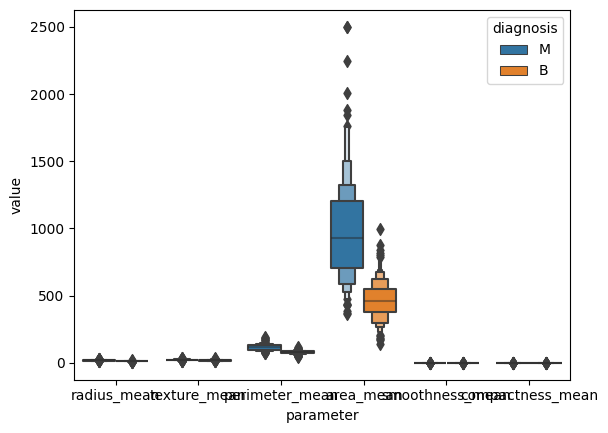

In [ ]:
sns.boxenplot(data = melted_df, x = 'parameter', y = 'value', hue = 'diagnosis')

<ipython-input-15-61e5ece110ad>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  hist = sns.distplot(cancer_data['area_mean'])


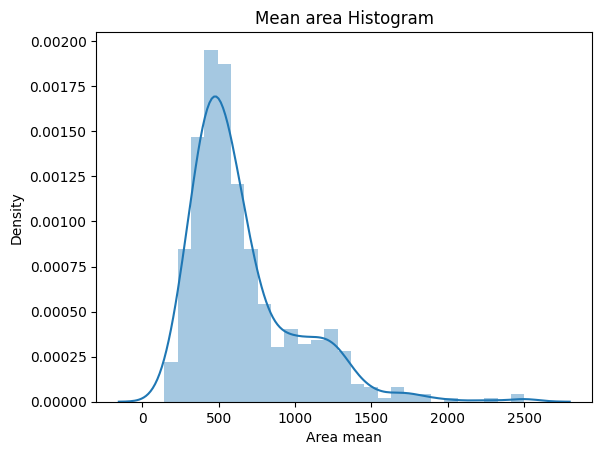

In [ ]:
hist = sns.distplot(cancer_data['area_mean'])
hist.set_title('Mean area Histogram')
hist.set_xlabel('Area mean')
hist.set_ylabel('Density')
plt.show()

In [ ]:
cancer_data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


<Axes: xlabel='area_mean', ylabel='perimeter_mean'>

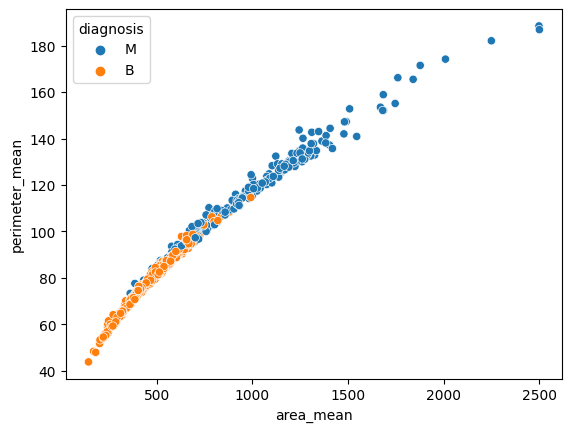

In [ ]:
# scatterplot
sns.scatterplot(data = cancer_data, x = 'area_mean', y = 'perimeter_mean', hue = 'diagnosis')

## ***Exercise:***

Try do visualise another parameters using scatterplot. Can you tell the any difference between patients goup?  

<ipython-input-25-94d3bec8e662>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(cancer_data_subset.corr())


<Axes: >

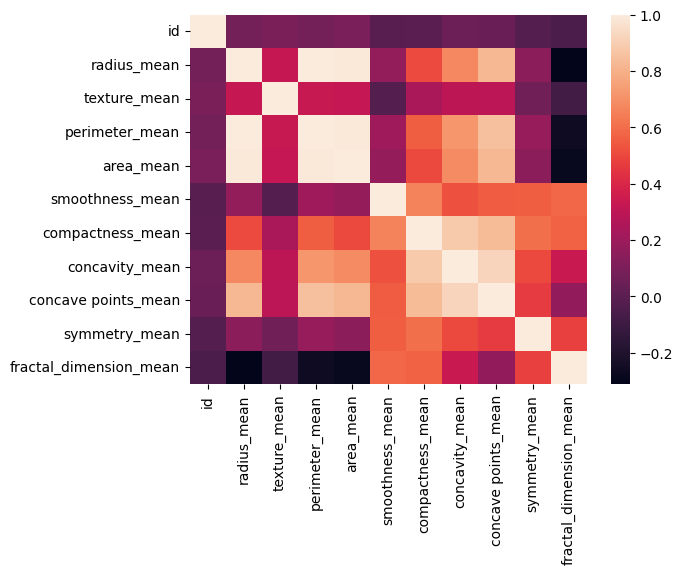

In [ ]:

sns.heatmap(cancer_data_subset.corr())

<ipython-input-26-f35fabe6fa1a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.clustermap(cancer_data_subset.corr())


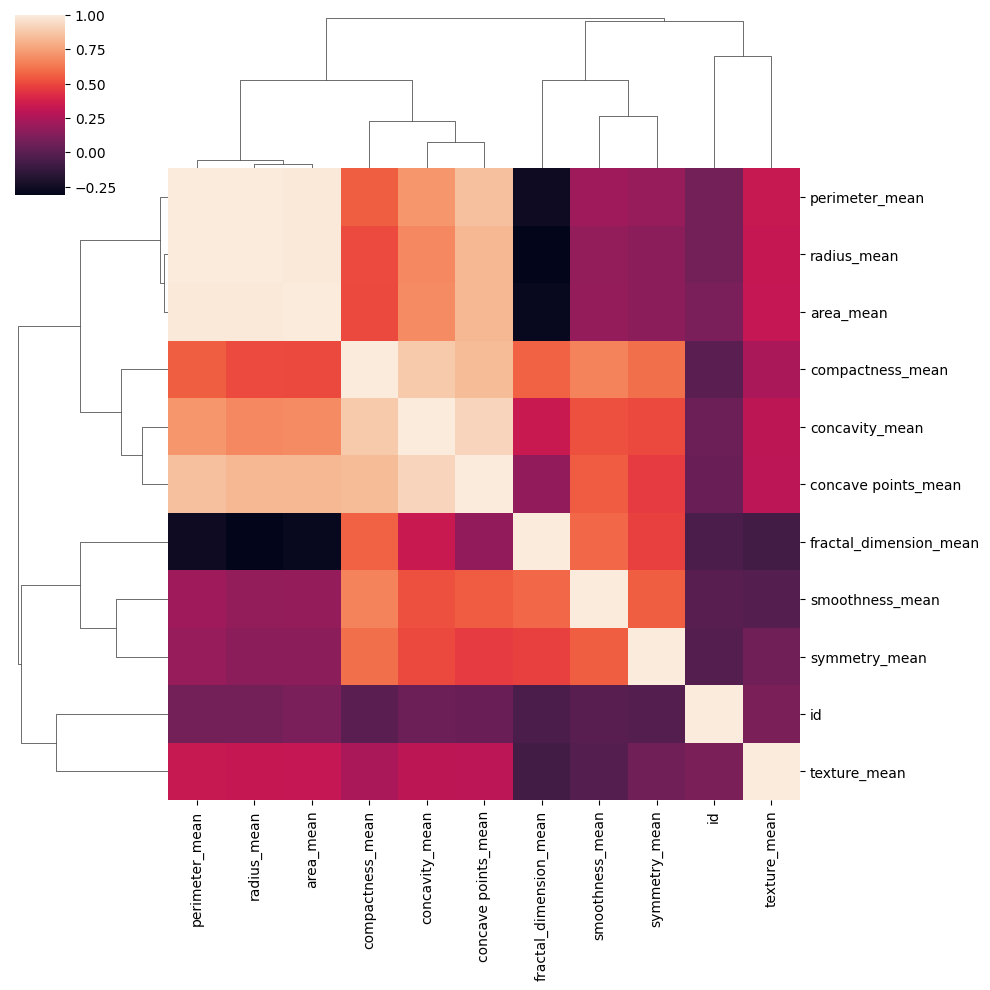

In [ ]:
sns.clustermap(cancer_data_subset.corr())b

In [ ]:
cancer_data_subset.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean'],
      dtype='object')

In [ ]:
# once again, only numerical data is shown
# but columns containing categorical data (diagnosis in our data)
# can be used as a parameter to group data into classes

sns.pairplot(cancer_data, hue = 'diagnosis')

# Polars: let's switch to a separate Jupyter notebook for excercises on Polars

<a target="_blank" href="https://colab.research.google.com/github/AdoHaha/PyConPL24_Pandas_Polars/blob/master/polars-robot.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

Below are simple operations that can help you switch from Pandas to Polars, but let's do a deep dive in a separate file

### Series in Polars

In [ ]:
## Create an example of series
series = pl.Series("Age", [28, 34, 45, 52, 45])

In [ ]:
series

Age
i64
28
34
45
52
45


In [ ]:
## Typical aggregation methods for Polars series: max(), min(), sum()

# Lets check the age of the oldest person
series.max()


52

In [ ]:
## How old in the youngest person?


In [ ]:
## What is the median of age?


In [ ]:
## How to sort data?  - Lets try to do it also with desceding order ;)

series.sort()

Age
i64
28
34
45
45
52


### Data frames in Polars

In [ ]:
## Prepare data frame in Polars

data = {
    "Patient ID": [1, 2, 3, 4, 5],
    "Name": ["Anna", "Bartek", "Cezary", None, "Ewa"],
    "Age": [28, 34, 45, 52, None],
    "Gender": ["Female", "Male", "Male", "Female", "Female"],
    "Blood Pressure": ["120/80", "130/85", "140/90", None, "125/80"],
    "Cholesterol Level": [195.5, 220.1, None, 230.2, 210.3],
    "Visit Date": [date(2023, 8, 15), date(2023, 8, 16), None, date(2023, 8, 18), date(2023, 8, 19)],
    "Smoker": [False, True, True, False, False],
    "Weight (kg)": [55, 78, 90, None, 64],
    "Height (cm)": [165, 180, 175, 160, None]
}

# Creating DataFrame
medical_df = pl.DataFrame(data)

# Displaying the DataFrame
print(medical_df)

shape: (5, 10)
┌────────────┬────────┬──────┬────────┬───┬────────────┬────────┬─────────────┬─────────────┐
│ Patient ID ┆ Name   ┆ Age  ┆ Gender ┆ … ┆ Visit Date ┆ Smoker ┆ Weight (kg) ┆ Height (cm) │
│ ---        ┆ ---    ┆ ---  ┆ ---    ┆   ┆ ---        ┆ ---    ┆ ---         ┆ ---         │
│ i64        ┆ str    ┆ i64  ┆ str    ┆   ┆ date       ┆ bool   ┆ i64         ┆ i64         │
╞════════════╪════════╪══════╪════════╪═══╪════════════╪════════╪═════════════╪═════════════╡
│ 1          ┆ Anna   ┆ 28   ┆ Female ┆ … ┆ 2023-08-15 ┆ false  ┆ 55          ┆ 165         │
│ 2          ┆ Bartek ┆ 34   ┆ Male   ┆ … ┆ 2023-08-16 ┆ true   ┆ 78          ┆ 180         │
│ 3          ┆ Cezary ┆ 45   ┆ Male   ┆ … ┆ null       ┆ true   ┆ 90          ┆ 175         │
│ 4          ┆ null   ┆ 52   ┆ Female ┆ … ┆ 2023-08-18 ┆ false  ┆ null        ┆ 160         │
│ 5          ┆ Ewa    ┆ null ┆ Female ┆ … ┆ 2023-08-19 ┆ false  ┆ 64          ┆ null        │
└────────────┴────────┴──────┴────────┴───┴──

In [ ]:
## What types of data do occur in the data frame?



In [ ]:
## Lets look at the data frame using methods head(), tail(), describe(), schema()


#### Subset of data frame

In [ ]:
# Subset of data using specific column names

df_selected = medical_df.select(['Patient ID', 'Gender'])

In [ ]:
df_selected

Patient ID,Gender
i64,str
1,"""Female"""
2,"""Male"""
3,"""Male"""
4,"""Female"""
5,"""Female"""


### Data filtration

In [ ]:
## Data filtration
medical_df.filter( pl.col('Age') >= 30)

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160


In [ ]:
## Data filtration with multiple parameters
medical_df.filter( pl.col('Age') >= 30, pl.col('Smoker') == True)

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175


### Adding and dropping columns
**df.with_columns() - the method using to add new column based on other columns**

In [ ]:
## Example: add new column with hight in feet

# feet = cm/30.48

medical_df.with_columns(
    (
      pl.col("Height (cm)")/30.48).round(2).alias("Height in feet")
    )

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm),Height in feet
i64,str,i64,str,str,f64,date,bool,i64,i64,f64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165,5.41
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180,5.91
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175,5.74
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160,5.25
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null,null


In [ ]:
##Excercise: Please add new column with BMI



#### Removing columns

In [ ]:
medical_df.drop('Height in feet')

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


#### Sorting

In [ ]:
medical_df.sort('Visit Date') ## sorting for various types of data ## from zero to hero

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


In [ ]:
medical_df.sort('Weight (kg)', descending=True) ## from hero to zero

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165


#### Grouping and aggregation
At first - filtration, and then - aggregation!

In [ ]:
medical_df.filter( pl.col('Age') >30 )['Cholesterol Level'].max()

230.2

In [ ]:
## Excercise

In [ ]:
## Grupowanie danych i wyliczanie różnych parametrów

In [ ]:
medical_df.group_by('Gender')

In [ ]:
medical_df.groupby("Gender").agg([
    pl.col("Weight (kg)").mean().alias("Average Weight (kg)")
])

<ipython-input-55-06dc3415f140>:1: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  medical_df.groupby("Gender").agg([


Gender,Average Weight (kg)
str,f64
"""Male""",84.0
"""Female""",59.5


In [ ]:
#### Multiple aggregation

medical_df.groupby("Gender").agg([
    pl.col("Weight (kg)").mean().alias("Average Weight (kg)"),
    pl.col("Cholesterol Level").mean().alias("Average Cholesterol Level")
])

<ipython-input-56-fbe674f2da56>:3: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  medical_df.groupby("Gender").agg([


Gender,Average Weight (kg),Average Cholesterol Level
str,f64,f64
"""Female""",59.5,212.0
"""Male""",84.0,220.1


In [ ]:
## Excercise: Do smokers have higher average cholersterol level?


#### Dealing with missing values

In [ ]:
## How many null values are in each column?

In [ ]:
medical_df.null_count()

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,1,1,0,1,1,1,0,1,1


In [ ]:
## Show subset of data frame having Null value in "Cholesterol Level"
medical_df.select( pl.col('Cholesterol Level').is_null())

Cholesterol Level
bool
false
false
true
false
false


In [ ]:
medical_df.filter( pl.col('Cholesterol Level').is_null())

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175


In [ ]:
### We want only rows with values of Cholesterol Level

In [ ]:
medical_df.filter( pl.col('Cholesterol Level').is_not_null())

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


In [ ]:
### Replace Null values with another value

medical_df.with_columns( pl.col('Cholesterol Level').fill_null(pl.lit(50))) ## example without any sense

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",50.0,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


In [ ]:
medical_df.with_columns( pl.col('Cholesterol Level').fill_null(strategy = 'forward'))

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",220.1,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


In [ ]:
medical_df.with_columns( pl.col('Cholesterol Level').fill_null(strategy = 'backward'))
## still, not porfect for data from patients

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",230.2,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


In [ ]:
medical_df.with_columns( pl.col('Cholesterol Level').interpolate())

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,date,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,2023-08-15,false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,2023-08-16,true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",225.15,null,true,90,175
4,null,52,"""Female""",null,230.2,2023-08-18,false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,2023-08-19,false,64,null


#### Write to file

In [ ]:
medical_df.write_csv('medical_df.csv')

#### Read csv

In [ ]:
medical_df_2 = pl.read_csv('medical_df.csv')

In [ ]:
medical_df_2

Patient ID,Name,Age,Gender,Blood Pressure,Cholesterol Level,Visit Date,Smoker,Weight (kg),Height (cm)
i64,str,i64,str,str,f64,str,bool,i64,i64
1,"""Anna""",28,"""Female""","""120/80""",195.5,"""2023-08-15""",false,55,165
2,"""Bartek""",34,"""Male""","""130/85""",220.1,"""2023-08-16""",true,78,180
3,"""Cezary""",45,"""Male""","""140/90""",null,null,true,90,175
4,null,52,"""Female""",null,230.2,"""2023-08-18""",false,null,160
5,"""Ewa""",null,"""Female""","""125/80""",210.3,"""2023-08-19""",false,64,null


### Plotting with hvplot package

In [ ]:
# Install hvplot if needed

#!pip install hvplot
#!pip install polars hvplot

In [ ]:
import hvplot.pandas

# barplot
pandas_df = medical_df.to_pandas()
#pandas_df['Cholesterol Level'].plot.bar()
pandas_df.hvplot.bar(x='Name', y='Cholesterol Level', height=400, width=700,
                            title="Cholesterol Levels by Name")

## if needed, use following code to display the plot

:Bars   [Name]   (Cholesterol Level)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
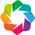

Launching server at http://localhost:39611


In [ ]:
import holoviews as hv
hv.extension('bokeh')  # This line ensures Holoviews uses Bokeh for rendering if it's not already set
hvplot.show(plot)

In [ ]:
## scatter plot

medical_df.plot.scatter(x = 'Age', y = 'Cholesterol Level')